<h1 align='center'>
<span style='color:lawngreen'>
<b>
TRAVEL INSURANCE PREDICTION
</b>
</h1>
<br>

## **| Process**

1. Read and Load data
2. Data analysis
3. Feature Engineering
4. Train-Test split
5. Build and Train model
6. Perform and Measure the Performance of model

<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
1 | Read and Load data
</b>
</span>
</h2>
<br>

A Travel Company Is Offering Travel Insurance Packages To Their Customers. The new insurance plan also covers Covid-19. The Company Claims To Know Which Customers Are Interested To Buy It Based On The Company's Database History.

- **Age**: Age of the Customer.
- **Employment Type**: The Sector in which Customer is employed.
- **GraduateOrNot**: Whether the Customer is college graduate or not.
- **AnnualIncome**: The yearly Income of the Customer in Indian Rupees.
- **FamilyMembers**: Number of Members in Customer's family.
- **ChronicDisease**: Whether the Customer suffers from any major disease or conditions like Diabetes/High BP or Asthama,...
- **FrequentFlyer**: Derived data based on Customer's History of Booking Air Tickets on atleast 4 different Instances in the last 2 years (2017-2019).
- **EverTravelledAbroad**: Has the Customer ever travelled to a foreign country.
- **TravelInsurance**: Did the Customer buy Travel Insurance Package during Introductory offering held in the year 2019.

Our target is `TravelInsurance` column.

In [33]:
import numpy as np
import pandas as pd

import os
import sys
sys.path.append(os.path.abspath('../'))
import utils

In [34]:
df = utils.read_dataset('TravelInsurancePrediction.csv')

The first three rows of this data frame:


,Unnamed: 0,Age,Employment Type,GraduateOrNot,AnnualIncome,FamilyMembers,ChronicDiseases,FrequentFlyer,EverTravelledAbroad,TravelInsurance
0,0,31,Government Sector,Yes,400000,6,1,No,No,0
1,1,31,Private Sector/Self Employed,Yes,1250000,7,0,No,No,0
2,2,34,Private Sector/Self Employed,Yes,500000,4,1,No,No,1


Description of this dataframe:


,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,1987.0,993.000000,573.741812,0.0,496.5,993.0,1489.5,1986.0
Age,1987.0,29.650226,2.913308,25.0,28.0,29.0,32.0,35.0
AnnualIncome,1987.0,932762.959235,376855.684748,300000.0,600000.0,900000.0,1250000.0,1800000.0
FamilyMembers,1987.0,4.752894,1.609650,2.0,4.0,5.0,6.0,9.0
ChronicDiseases,1987.0,0.277806,0.448030,0.0,0.0,0.0,1.0,1.0
TravelInsurance,1987.0,0.357323,0.479332,0.0,0.0,0.0,1.0,1.0


<br>

Establish essential modules and define unified style for plotting:

In [35]:
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')

font = {
  'fontsize': 16,
  'fontstyle': 'normal',
  'backgroundcolor': 'black',
  'color': 'white'
}
color = 'PiYG'

%matplotlib inline
plt.style.use('_mpl-gallery')
plt.style.use('seaborn-v0_8')

<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
2 | Data Analysis
</b>
</h2>

First, we drop the 'Unnamed: 0' column.

In [36]:
df.drop(columns=['Unnamed: 0'], inplace=True)
df.columns

Index(['Age', 'Employment Type', 'GraduateOrNot', 'AnnualIncome',
       'FamilyMembers', 'ChronicDiseases', 'FrequentFlyer',
       'EverTravelledAbroad', 'TravelInsurance'],
      dtype='object')

In [37]:
# Check null values
df.isna().sum()

Age                    0
Employment Type        0
GraduateOrNot          0
AnnualIncome           0
FamilyMembers          0
ChronicDiseases        0
FrequentFlyer          0
EverTravelledAbroad    0
TravelInsurance        0
dtype: int64

In [38]:
# Check duplicated values
df.duplicated().sum()

np.int64(738)

> Insight: The dataset has 382 duplicate values ​​(19.2%). This number is too large to remove so I will add noise to these values ​​to avoid overfitting.

<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
2.1 | Classify data
</b>
</h3>

<br>

Because data was processed, so we change the type of 2 columns: `ChronicDiseases` and `TravelInsurance` to **str**.

In [39]:
df = df.astype({
    'ChronicDiseases': str,
    'TravelInsurance': str
})
df = df.rename(columns={'TravelInsurance': 'target'})
df.columns

Index(['Age', 'Employment Type', 'GraduateOrNot', 'AnnualIncome',
       'FamilyMembers', 'ChronicDiseases', 'FrequentFlyer',
       'EverTravelledAbroad', 'target'],
      dtype='object')

<br>

Show numerical and categorical data from dataset.

In [40]:
cat_df = df.select_dtypes(exclude='number')
num_df = df.select_dtypes(include='number')

print(f'Categorical columns:\n{cat_df.columns}')
print(f'\nNumerical columns:\n{num_df.columns}')

Categorical columns:
Index(['Employment Type', 'GraduateOrNot', 'ChronicDiseases', 'FrequentFlyer',
       'EverTravelledAbroad', 'target'],
      dtype='object')

Numerical columns:
Index(['Age', 'AnnualIncome', 'FamilyMembers'], dtype='object')


<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
2.2 | Visualize Categorical data
</b>
</span>
</h3>

<br>

Build visualization function for categorical dataframe:

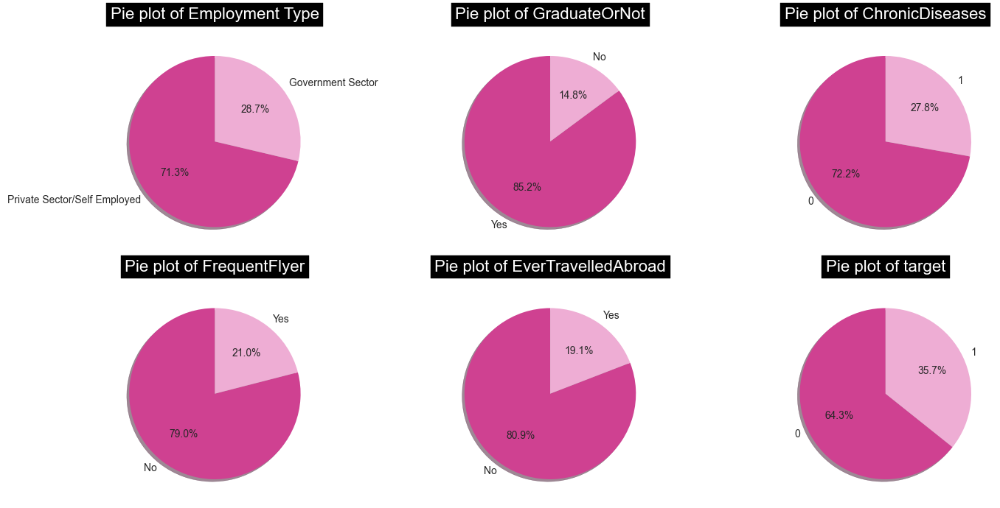

In [41]:
utils.custom_pieplot(df=cat_df, ncols=3, figsize=(15, 7), color=color)

> Insight: Looking at the Travel Insurance (target) chart, the number of people who do not buy insurance is higher (64.3%). However, in reality, this ratio is balanced and there is no big difference.

<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
2.3 | Visualize Numeric data
</b>
</span>
</h3>

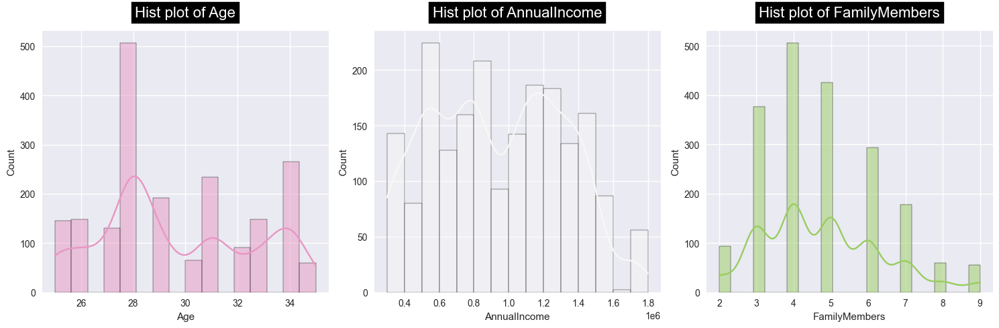

In [42]:
utils.custom_histplot(df=num_df, ncols=3, figsize=(15, 5), color=color )

<br>

Now let's draw box plot to detect outliers in numerical data.

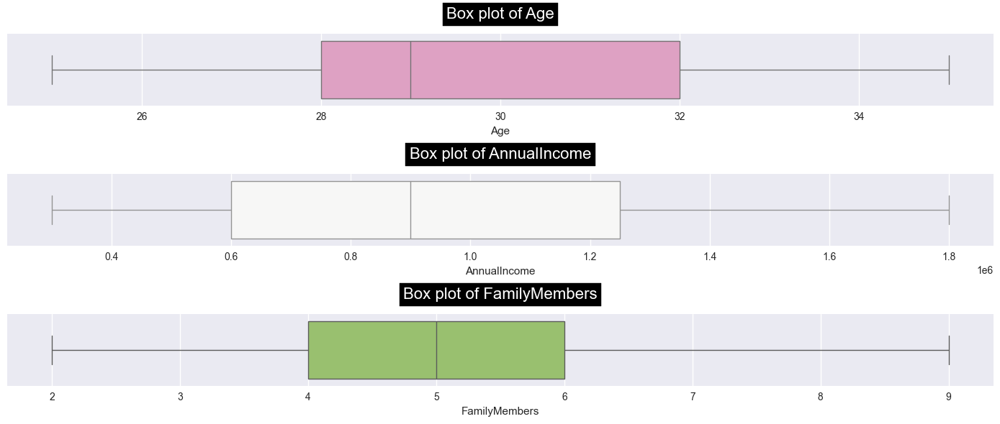

In [43]:
utils.custom_boxplot(df=num_df, ncols=1, color=color)

> Insight: Because except for the excessive duplicate values ​​mentioned above, the data does not have any other errors, nor outliers, so the preprocessing step is only used to handle them.

<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
3 | Data Preprocessing
</b>
</span>
</h2>

In [44]:
def preprocessing_data(df):
    '''
      Preprocess your data (eg. Drop null datapoints or fill missing data)
      :param df: pandas DataFrame
      :return: pandas DataFrame
    '''
    df['AnnualIncome'] = df['AnnualIncome'].apply(utils.add_noise)
    return df

In [45]:
processed_df = preprocessing_data(df.copy())
processed_df.duplicated().sum()

np.int64(0)

<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
4 | Feature Engineering
</b>
</span>
</h2>

In [46]:
def apply_feature_engineering(
    df: pd.DataFrame, cat_df: pd.DataFrame, drop_col: str
) -> None:
    '''
    Apply all feature engineering to transform your data into number
    :param df: pandas DataFrame
    :return: pandas DataFrame
    '''
    for col in cat_df.columns:
        df[col] = df[col].astype('category').cat.codes
    return df

fe_df = apply_feature_engineering(
    df=processed_df.copy(), cat_df=cat_df, drop_col='target'
)

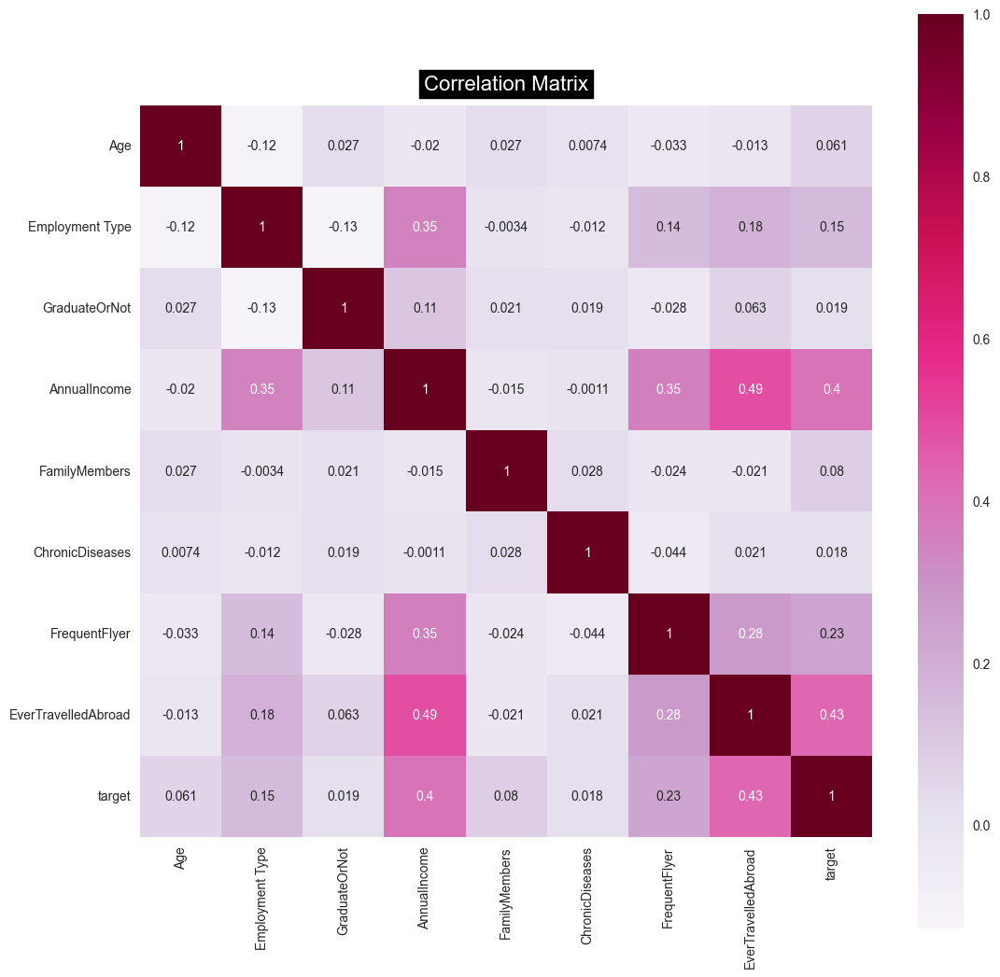

In [47]:
utils.custom_heatmap(df=fe_df, figsize=(10, 10), color='PuRd')

In [48]:
# fe_df.head()

<br>

Prepare data for train-test split step:

In [49]:
X, y = utils.prepare_x_y(df=fe_df, target='target')
print(f'X shape: {X.shape}\nY shape: {y.shape}')

X shape: (1987, 8)
Y shape: (1987, 1)


<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
5 | Split data
</b>
</h2>

In [50]:
from sklearn.model_selection import train_test_split

RANDOM_STATE = 24
TRAIN_SIZE = 0.8

trainX, testX ,trainY, testY = train_test_split(
    X, y, train_size=TRAIN_SIZE, random_state=RANDOM_STATE, shuffle=True
)
print(f'Train X shape: {trainX.shape}')
print(f'Train y shape: {trainY.shape}')
print(f'Test X shape: {testX.shape}')
print(f'Test y shape: {testY.shape}')

Train X shape: (1589, 8)
Train y shape: (1589, 1)
Test X shape: (398, 8)
Test y shape: (398, 1)


<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
6 | Naive Bayes model
</b>
</h2>

In [51]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV
from sklearn.naive_bayes import GaussianNB, BernoulliNB
from sklearn.base import ClassifierMixin
from typing import Dict, Any

<br>

Build the function to choose best parameter to build our model:

In [52]:
def tune_model(
    model: ClassifierMixin,
    param_grid: Dict[str, list],
    cv: int = 5,
    scoring: str = 'recall_weighted',
    X: np.array = trainX,
    y: np.array = trainY,
) -> Dict[str, Any]:
    '''
        Find the best params for your model above (including your best params)
        :param model: the model you have design
        :return: a model with best params
    '''
    grid_search = GridSearchCV(
        estimator=model,
        param_grid=param_grid,
        cv=cv,
        scoring=scoring,
        n_jobs=-1,
        verbose=1
    )
    grid_search.fit(X, y)
    return grid_search

<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
6.1 | Gaussian NB
</b>
</span>
</h3>

In [53]:
def build_model_gaunb(X: np.array = trainX, y: np.array = trainY):
    '''
    Design your model and train it (including your best params)
    :param X: feature matrix
    :param y: target
    :return: a model
    '''
    pipe = Pipeline(steps=[
        ('scaler', MinMaxScaler()),
        ('pca', PCA()),
        ('gau_nb', GaussianNB())
    ])

    param_grid = {
        'scaler__feature_range': [(-1, 1), (0, 1)],
        'pca__n_components': [2, 5, 10],
        'gau_nb__var_smoothing': np.logspace(-4, -9, num=100)
    }
    
    model = tune_model(
        model=pipe, param_grid=param_grid, cv=10
    )
    return model

In [54]:
gau_nb = build_model_gaunb()

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: divide by zero encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: overflow encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: invalid value encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: divide by zero encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/d

In [55]:
display(gau_nb.best_params_)
print('Best parameter (CV score=%0.3f):' % gau_nb.best_score_)

{'gau_nb__var_smoothing': np.float64(0.0001),
 'pca__n_components': 5,
 'scaler__feature_range': (-1, 1)}

Best parameter (CV score=0.757):


In [56]:
gau_pred = gau_nb.predict(testX)
utils.calculate_performance(y_true=testY, y_pred=gau_pred, main_score='f1')

Precision: 0.7211538461538461
Recall: 0.5319148936170213
Accuracy: 0.7613065326633166
F1: 0.6122448979591837
Confusion matrix:
[[228  29]
 [ 66  75]]
Classification report:
              precision    recall  f1-score   support

           0       0.78      0.89      0.83       257
           1       0.72      0.53      0.61       141

    accuracy                           0.76       398
   macro avg       0.75      0.71      0.72       398
weighted avg       0.76      0.76      0.75       398



0.6122448979591837

<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
6.2 | Bernoulli NB
</b>
</span>
</h3>

In [57]:
def build_model_bernb(X: np.array = trainX, y: np.array = trainY):
    '''
    Design your model and train it (including your best params)
    :param X: feature matrix
    :param y: target
    :return: a model
    '''
    pipe = Pipeline(steps=[
        ('pca', PCA()),
        ('ber_nb', BernoulliNB())
    ])
    param_grid = {
        'pca__n_components': [2, 5, 10],
        'ber_nb__alpha': np.logspace(-1, -9, num=100),
        'ber_nb__fit_prior': [True, False]
    }
    model = tune_model(
        model=pipe, param_grid=param_grid, cv=8
    )
    return model

In [58]:
ber_nb = build_model_bernb(trainX, trainY)

/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: divide by zero encountered in matmul
  C = X.T @ X


Fitting 8 folds for each of 600 candidates, totalling 4800 fits


/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: overflow encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: invalid value encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: divide by zero encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: invalid value encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3

In [59]:
display(ber_nb.best_params_)
print('Best parameter (CV score=%0.3f):' % ber_nb.best_score_)

{'ber_nb__alpha': np.float64(0.1),
 'ber_nb__fit_prior': True,
 'pca__n_components': 2}

Best parameter (CV score=0.652):


In [60]:
ber_pred = ber_nb.predict(testX)
utils.calculate_performance(y_true=testY, y_pred=ber_pred, main_score='recall')

Precision: 0.6352941176470588
Recall: 0.3829787234042553
Accuracy: 0.7035175879396985
F1: 0.4778761061946903
Confusion matrix:
[[226  31]
 [ 87  54]]
Classification report:
              precision    recall  f1-score   support

           0       0.72      0.88      0.79       257
           1       0.64      0.38      0.48       141

    accuracy                           0.70       398
   macro avg       0.68      0.63      0.64       398
weighted avg       0.69      0.70      0.68       398



0.3829787234042553

>Insight: Because bernoulli gives very low recall (38%), the model is strongly biased towards class 0, it is easy to predict wrongly as class 1, so we will oversample class 1 to handle this imbalanced problem.

<br>

<h3 align='center'>
<span style='background:palegreen; color:grey'>
<b>
6.3 | Oversampling class 1
</b>
</span>
</h3>

In [62]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=42)
trainX_oversampling, trainY_oversampling= smote.fit_resample(trainX, trainY)

In [63]:
# Retrain GaussianNB
gau_oversampling = build_model_gaunb(trainX_oversampling, trainY_oversampling)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: divide by zero encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: overflow encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: invalid value encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: divide by zero encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/d

In [64]:
display(gau_oversampling.best_params_)
print('Best parameter (CV score=%0.3f):' % gau_oversampling.best_score_)

gau_oversampling_pred = gau_oversampling.predict(testX)
utils.calculate_performance(y_true=testY, y_pred=gau_oversampling_pred, main_score='recall')

{'gau_nb__var_smoothing': np.float64(0.0001),
 'pca__n_components': 5,
 'scaler__feature_range': (-1, 1)}

Best parameter (CV score=0.757):
Precision: 0.7211538461538461
Recall: 0.5319148936170213
Accuracy: 0.7613065326633166
F1: 0.6122448979591837
Confusion matrix:
[[228  29]
 [ 66  75]]
Classification report:
              precision    recall  f1-score   support

           0       0.78      0.89      0.83       257
           1       0.72      0.53      0.61       141

    accuracy                           0.76       398
   macro avg       0.75      0.71      0.72       398
weighted avg       0.76      0.76      0.75       398



0.5319148936170213

In [65]:
# Retrain BernoulliNB
ber_oversampling = build_model_bernb(trainX_oversampling, trainY_oversampling)

Fitting 8 folds for each of 600 candidates, totalling 4800 fits


/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: divide by zero encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: overflow encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_pca.py:606: RuntimeWarning: invalid value encountered in matmul
  C = X.T @ X
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: divide by zero encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/decomposition/_base.py:148: RuntimeWarning: overflow encountered in matmul
  X_transformed = X @ self.components_.T
/Users/trantrieunghi/Desktop/NMMH/Lab/.venv/lib/python3.13/site-packages/sklearn/d

In [66]:
display(ber_oversampling.best_params_)
print('Best parameter (CV score=%0.3f):' % ber_oversampling.best_score_)

ber_oversampling_pred = ber_oversampling.predict(testX)
utils.calculate_performance(y_true=testY, y_pred=ber_oversampling_pred, main_score='recall')

{'ber_nb__alpha': np.float64(0.1),
 'ber_nb__fit_prior': True,
 'pca__n_components': 2}

Best parameter (CV score=0.652):
Precision: 0.6352941176470588
Recall: 0.3829787234042553
Accuracy: 0.7035175879396985
F1: 0.4778761061946903
Confusion matrix:
[[226  31]
 [ 87  54]]
Classification report:
              precision    recall  f1-score   support

           0       0.72      0.88      0.79       257
           1       0.64      0.38      0.48       141

    accuracy                           0.70       398
   macro avg       0.68      0.63      0.64       398
weighted avg       0.69      0.70      0.68       398



0.3829787234042553

Because the number of class 0 is much more than class 1, we will use Precision-Recall curves to evaluate the model.

GaussianNB: F1=0.612, Auc=0.652


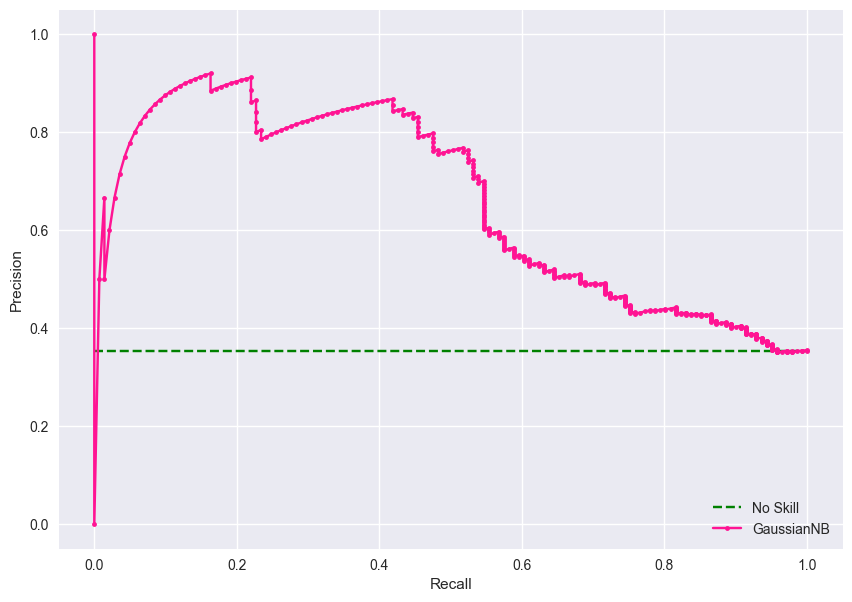

In [106]:
# import scikitplot as skplt
from sklearn.metrics import f1_score, auc, precision_recall_curve
def custom_pr_curve(
    model: ClassifierMixin,
    name_model: str,
    x_test: np.array,
    y_test: np.array
):
    # Predict probabilities
    y_pred = model.predict_proba(x_test)[:, 1] # keep probabilities for the positive outcome only
    # Predict class values
    yhat = model.predict(x_test)
    prec, rec, thresh = precision_recall_curve(testY, y_pred)
    f1, auc_ = f1_score(testY, yhat), auc(rec, prec)
    # Summarize scores
    print(f'{name_model}: F1={round(f1, 3)}, Auc={round(auc_, 3)}')

    # Plot the precision-recall curves
    no_skill = len(testY[testY==1]) / len(testY)
    plt.plot(
        [0, 1], [no_skill, no_skill], linestyle='--', label='No Skill', color='green'
    )
    plt.plot(rec, prec, marker='.', label=name_model, color='deeppink')
    # Axis labels
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.legend(loc='lower right')
    plt.grid(True)
    plt.show()

    # plt.figure(figsize=(10, 6))
    # plt.plot(
    #     thresh,
    #     prec[:-1],
    #     color='green',
    #     linestyle=":",
    #     linewidth=4,
    #     label=f'Precision curve of {name_model} model'
    # )
    # plt.plot(
    #     thresh,
    #     rec[:-1],
    #     color='deeppink',
    #     linestyle=":",
    #     linewidth=4,
    #     label=f'Recall curve of {name_model} model'
    # )
    # plt.xlabel('Recall')
    # plt.ylabel('Precision')
    # plt.legend(loc='best')
    # plt.title(f'Precision vs Recall curve of {name_model} model')
    # plt.legend(loc='lower right')
    # plt.grid(True)
    # plt.show()

custom_pr_curve(gau_oversampling, 'GaussianNB', testX, testY)

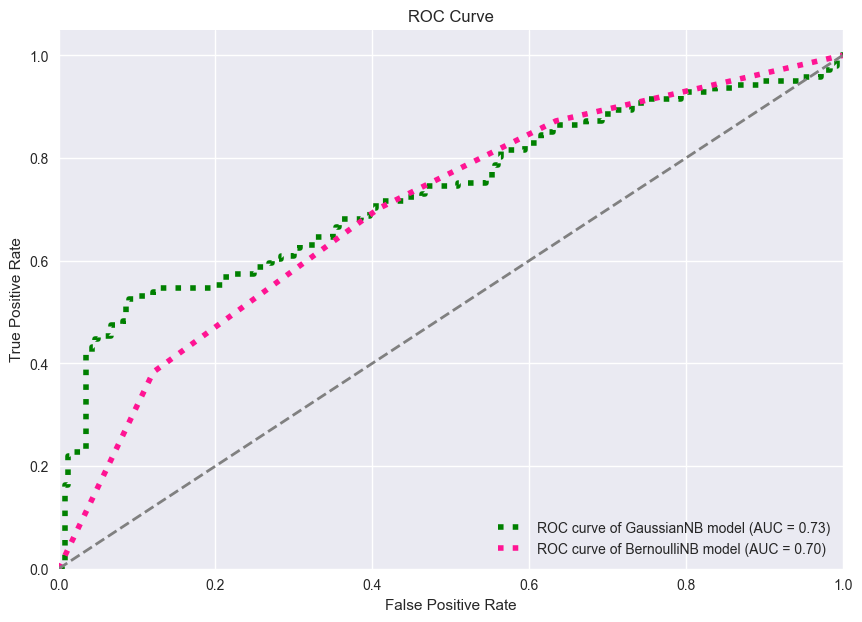

In [108]:
utils.custom_roc_curve(gau_oversampling, 'GaussianNB', ber_oversampling, 'BernoulliNB', testX, testY)

In [110]:
gau_oversampling_pred_ = gau_oversampling.predict(testX)
gau_y_proba = np.where(gau_oversampling_pred_[:] < 0.6)[0]
gau_rec = utils.calculate_performance(y_true=testY, y_pred=gau_oversampling_pred, main_score='recall')

Precision: 0.7211538461538461
Recall: 0.5319148936170213
Accuracy: 0.7613065326633166
F1: 0.6122448979591837
Confusion matrix:
[[228  29]
 [ 66  75]]
Classification report:
              precision    recall  f1-score   support

           0       0.78      0.89      0.83       257
           1       0.72      0.53      0.61       141

    accuracy                           0.76       398
   macro avg       0.75      0.71      0.72       398
weighted avg       0.76      0.76      0.75       398



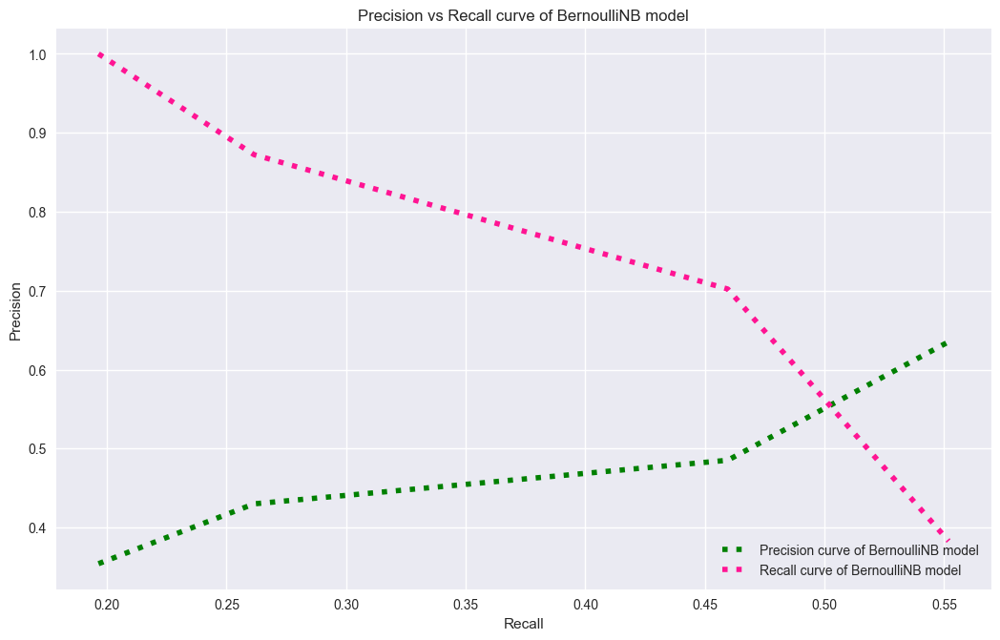

In [88]:
custom_pr_curve(ber_oversampling, 'BernoulliNB', testX, testY)

In [109]:
ber_oversampling_pred_ = ber_oversampling.predict(testX)
ber_y_proba = np.where(ber_oversampling_pred_[:] < 0.6)[0]
ber_rec = utils.calculate_performance(y_true=testY, y_pred=ber_oversampling_pred_, main_score='recall')

Precision: 0.6352941176470588
Recall: 0.3829787234042553
Accuracy: 0.7035175879396985
F1: 0.4778761061946903
Confusion matrix:
[[226  31]
 [ 87  54]]
Classification report:
              precision    recall  f1-score   support

           0       0.72      0.88      0.79       257
           1       0.64      0.38      0.48       141

    accuracy                           0.70       398
   macro avg       0.68      0.63      0.64       398
weighted avg       0.69      0.70      0.68       398



<br>

<h2 align='center'>
<span style='background:black; color:lawngreen'>
<b>
6 | Perform and Measure the Performance of model
</b>
</h2>

<br>

Show the performance of our model:

In [ ]:
# y_test = y_test.astype('int')

# y_pred = stack_model().predict_proba(X_test)
# y_pred = np.where(y_pred[:, 0] > 0.595, 0, 1)

# show_performance(y_pred=y_pred, y_true=y_test)

In [ ]:
# display_ = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_pred))

# display_.plot()

# plt.show()